In [ ]:
import numpy as np 
import pandas as pd 
import os
import torch
import torchvision
from glob import glob
import torch.nn as nn
from tqdm import tqdm
import matplotlib.pyplot as plt
import torch.nn.functional as F
import torchvision.transforms as transform
from torch.utils.data import DataLoader,Dataset
from torch.utils.tensorboard import SummaryWriter
from torchvision.utils import make_grid


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp /content/drive/MyDrive/archive.zip -d /content/archive.zip

In [ ]:
!unzip /content/archive.zip

Streaming output truncated to the last 5000 lines.
  inflating: cityscapes_data/cityscapes_data/train/2754.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2755.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2756.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2757.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2758.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2759.jpg  
  inflating: cityscapes_data/cityscapes_data/train/276.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2760.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2761.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2762.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2763.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2764.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2765.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2766.jpg  
  inflating: cityscapes_data/cityscapes_data/train/2767.jpg  
  inflating: citysca

In [ ]:
!cp /content/drive/MyDrive/modelDumps/RESNETNET50withUNET.zip -d /content/RESNETNET50withUNET.zip

In [ ]:
!unzip /content/RESNETNET50withUNET.zip

Archive:  /content/RESNETNET50withUNET.zip
  inflating: RESNETNET50withUNET.pth  


In [ ]:
train_path = glob('/content/cityscapes_data/train/*')
valid_path = glob('/content/cityscapes_data/val/*')

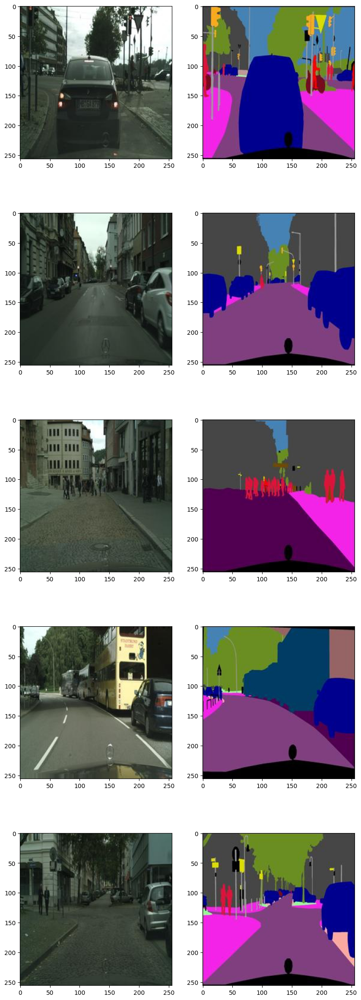

In [ ]:
fig,ax = plt.subplots(5,2,figsize=(10,30))
for i in range(5):
    img = plt.imread(train_path[i])
    ax[i][0].imshow(img[:,:256])
    ax[i][1].imshow(img[:,256:])

In [ ]:
train_dataset = []
validation_dataset = []

In [ ]:
class MyDataset(Dataset):
    def __init__(self, images_path ,transform_img ,transform_label):
        
        self.images_path = images_path
        self.transform_img = transform_img
        self.transform_label = transform_label
    def __len__(self):
        return len(self.images_path)
    def __getitem__(self, idx):  
        img = plt.imread(self.images_path[idx])
        image,label = img[:,:int(img.shape[1]/2)],img[:,int(img.shape[1]/2):]
        if self.transform_img:
            image = self.transform_img(image)      
        if self.transform_label:
            label = self.transform_label(label)       
        return image, label

In [ ]:
mytransformsImage = transform.Compose([   
        transform.ToTensor(),
        transform.Resize((256*2,256*2)),])
mytransformsLabel = transform.Compose([
        transform.ToTensor(),
        transform.Resize((256*2,256*2)),])

In [ ]:
traindata = MyDataset(train_path,transform_img= mytransformsImage,transform_label= mytransformsLabel)

In [ ]:
valdata = MyDataset(valid_path, mytransformsImage, mytransformsLabel)

In [ ]:
batch_size = 4
train_loader = DataLoader(traindata,batch_size)
val_loader = DataLoader(valdata,4)

In [ ]:
for i,j in train_loader:
  break

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
img[0].shape

(512, 3)

In [ ]:
def show(img,output,label,denorm = False):
    img,output,label = img.cpu(),output.cpu(),label.cpu()
    fig,ax = plt.subplots(len(output),3,figsize=(10,10))
    
    for i in range(len(output)):
        if(len(output) == 3):
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[i][0].imshow(Img.permute(1,2,0))
            ax[i][1].imshow(Lab)
            ax[i][2].imshow(act.permute(1,2,0))
        else:
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[0].imshow(Img.permute(1,2,0))
            ax[1].imshow(Lab)
            ax[2].imshow(act.permute(1,2,0))
    plt.show()

In [ ]:
class Convblock(nn.Module): 
      def __init__(self,input_channel,output_channel,kernal=3,stride=1,padding=1):     
        super().__init__()
        self.convblock = nn.Sequential(
            nn.Conv2d(input_channel,output_channel,kernal,stride,padding),
            nn.BatchNorm2d(output_channel),
            nn.ReLU(inplace=True),
            nn.Conv2d(output_channel,output_channel,kernal),
            nn.ReLU(inplace=True),
        )
      def forward(self,x):
        x = self.convblock(x)
        return x

In [ ]:
import torchvision.models as models

class UNet(nn.Module):
    def __init__(self, input_channel, retain=True):
        super().__init__()
        self.resnet50 = models.resnet50(pretrained=True)
        self.conv1 = Convblock(512*2,32)
        self.conv2 = Convblock(32,64)
        self.conv3 = Convblock(64,128)
        self.conv4 = Convblock(128,256)
        self.neck = nn.Conv2d(256,512,3,1)
        self.upconv4 = nn.ConvTranspose2d(512,256,3,2,0,1)
        self.dconv4 = Convblock(512,256)
        self.upconv3 = nn.ConvTranspose2d(256,128,3,2,0,1)
        self.dconv3 = Convblock(256,128)
        self.upconv2 = nn.ConvTranspose2d(128,64,3,2,0,1)
        self.dconv2 = Convblock(128,64)
        self.upconv1 = nn.ConvTranspose2d(64,32,3,2,0,1)
        self.dconv1 = Convblock(64,32)
        self.out = nn.Conv2d(32,3,1,1)
        self.retain = retain
        
    def forward(self,x):
        con = self.resnet50(x) 
        conv1 = self.conv1(con)
        #pool1 = F.max_pool2d(conv1,kernel_size=2,stride=2)
        #print(conv1.shape)
        conv2 = self.conv2(conv1)
        #pool2 = F.max_pool2d(conv2,kernel_size=2,stride=2)
        conv3 = self.conv3(conv2)
        pool3 = F.max_pool2d(conv3,kernel_size=2,stride=2)  
        conv4 = self.conv4(pool3) 
        pool4 = F.max_pool2d(conv4,kernel_size=2,stride=2)
        neck = self.neck(pool4)
        upconv4 = self.upconv4(neck)
        croped = self.crop(conv4,upconv4)
        dconv4 = self.dconv4(torch.cat([upconv4,croped],1))
        upconv3 = self.upconv3(dconv4)
        croped = self.crop(conv3,upconv3)
        dconv3 = self.dconv3(torch.cat([upconv3,croped],1))
        upconv2 = self.upconv2(dconv3)
        croped = self.crop(conv2,upconv2)
        dconv2 = self.dconv2(torch.cat([upconv2,croped],1))
        upconv1 = self.upconv1(dconv2)
        croped = self.crop(conv1,upconv1)
        dconv1 = self.dconv1(torch.cat([upconv1,croped],1))
        out = self.out(dconv1)
        if self.retain == True:
            out = F.interpolate(out,list(x.shape)[2:])
        return out
    def crop(self,input_tensor,target_tensor):
        _,_,H,W = target_tensor.shape
        return transform.CenterCrop([H,W])(input_tensor)

In [ ]:
model = UNet(3).float().to(device)

In [ ]:
lr = 0.001
epochs = 40

In [ ]:
lossfunc = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

In [ ]:
train_acc = []
val_acc = []
train_loss = []
val_loss = []
for i,j in train_loader:
  break

  0%|          | 0/744 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
100%|██████████| 744/744 [03:52<00:00,  3.20it/s]


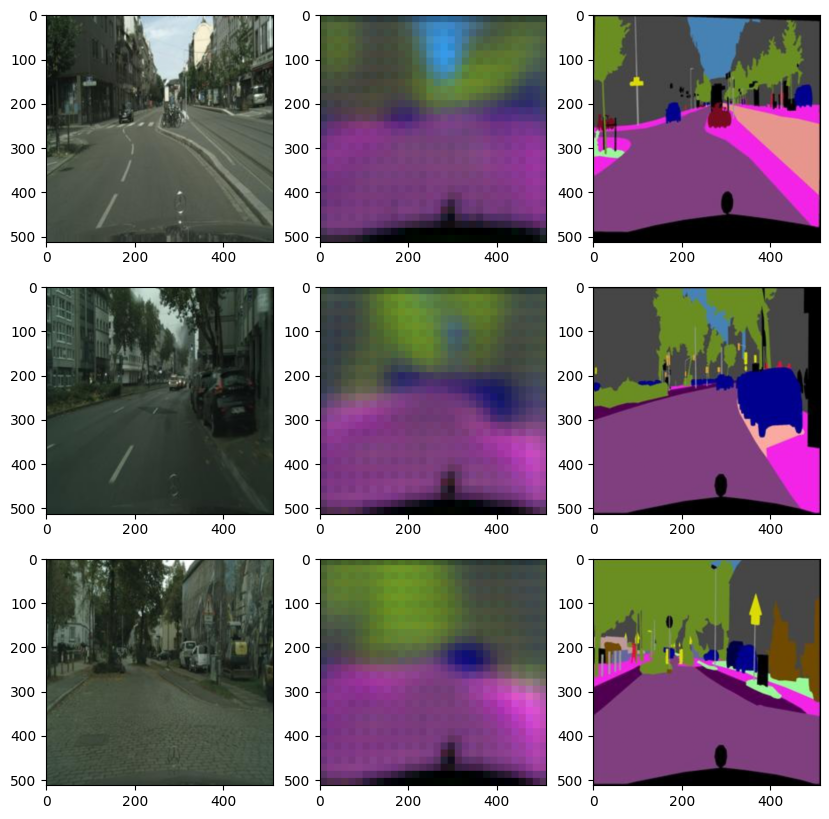

100%|██████████| 125/125 [00:20<00:00,  5.98it/s]


epoch : 0 ,train loss : 0.026800014744562808 ,valid loss : 0.022907208763062955 


100%|██████████| 125/125 [00:20<00:00,  6.17it/s]


epoch : 1 ,train loss : 0.022023583101409096 ,valid loss : 0.020271620698273183 


100%|██████████| 744/744 [03:54<00:00,  3.18it/s]


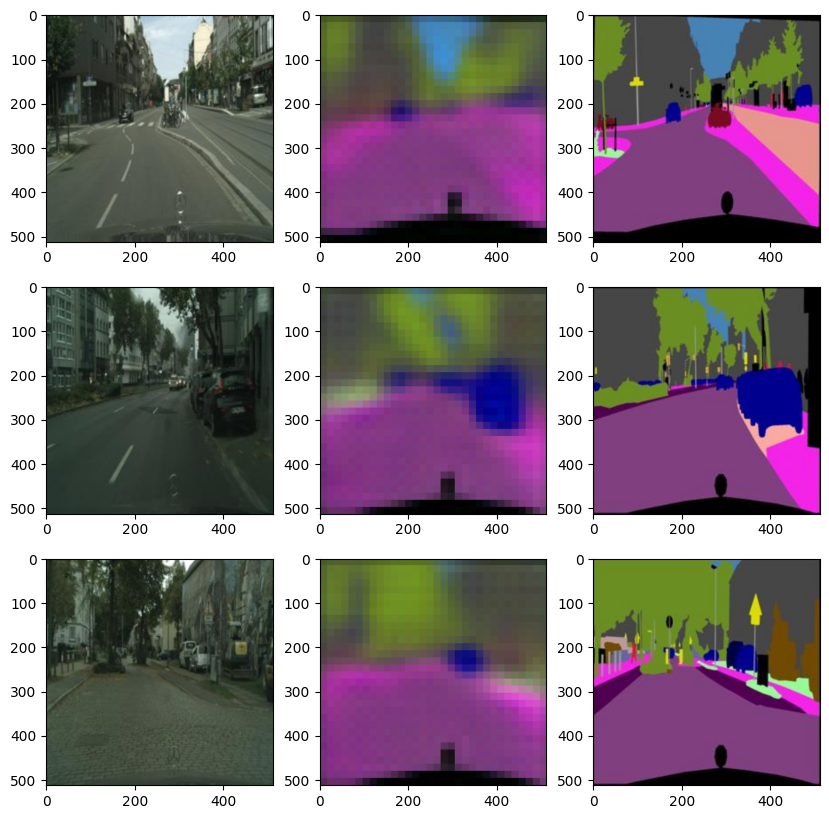

100%|██████████| 125/125 [00:20<00:00,  6.19it/s]


epoch : 2 ,train loss : 0.01965512879823725 ,valid loss : 0.018693180181086063 


100%|██████████| 125/125 [00:20<00:00,  6.03it/s]


epoch : 3 ,train loss : 0.018331114060035156 ,valid loss : 0.017552437528967856 


100%|██████████| 744/744 [03:55<00:00,  3.16it/s]


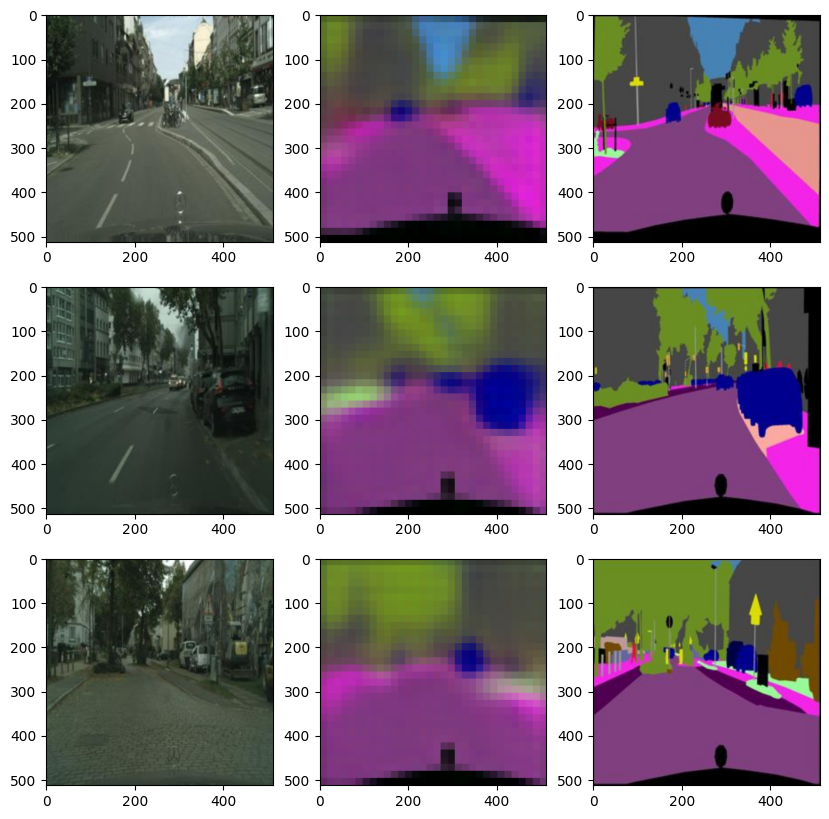

100%|██████████| 125/125 [00:20<00:00,  6.02it/s]


epoch : 4 ,train loss : 0.017434244617439247 ,valid loss : 0.016925684556365013 


100%|██████████| 125/125 [00:22<00:00,  5.61it/s]


epoch : 5 ,train loss : 0.016693209282933705 ,valid loss : 0.016642902158200742 


100%|██████████| 744/744 [03:57<00:00,  3.13it/s]


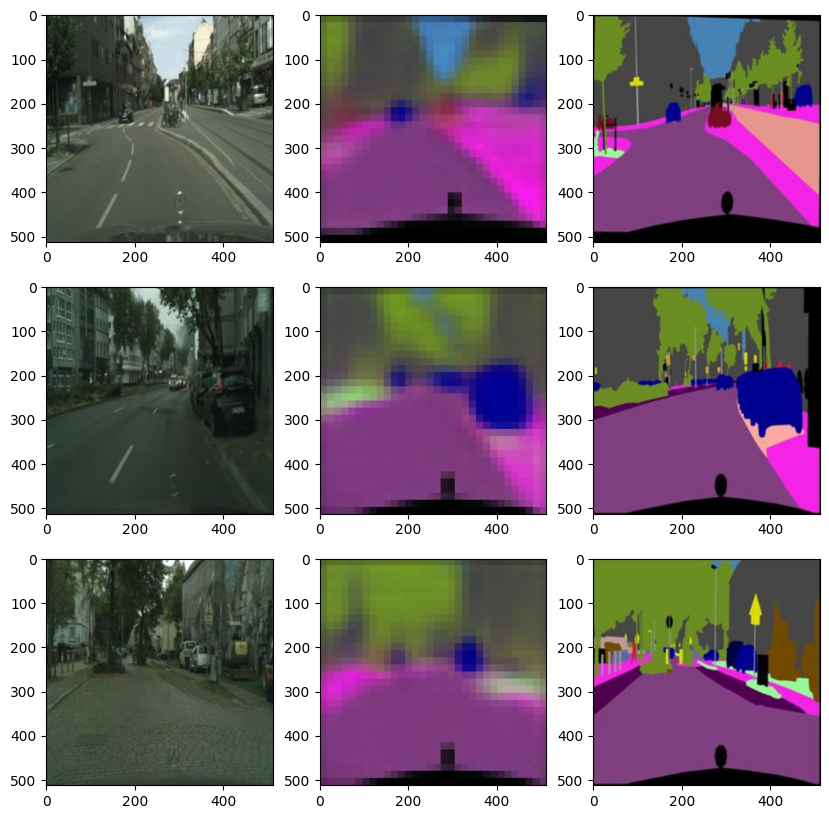

100%|██████████| 125/125 [00:21<00:00,  5.77it/s]


epoch : 6 ,train loss : 0.01607015599516691 ,valid loss : 0.01639196852594614 


100%|██████████| 125/125 [00:21<00:00,  5.88it/s]


epoch : 7 ,train loss : 0.015589832833978117 ,valid loss : 0.016202613420784474 


100%|██████████| 744/744 [03:59<00:00,  3.10it/s]


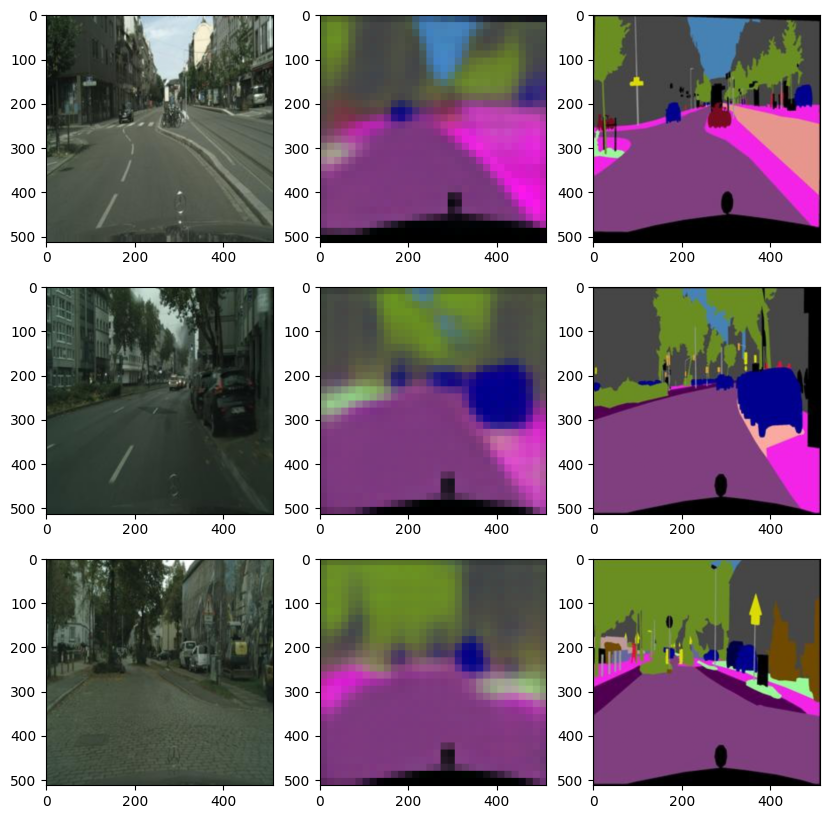

100%|██████████| 125/125 [00:21<00:00,  5.87it/s]


epoch : 8 ,train loss : 0.015127898764706427 ,valid loss : 0.016284329771995544 


100%|██████████| 125/125 [00:21<00:00,  5.78it/s]


epoch : 9 ,train loss : 0.014687231208588327 ,valid loss : 0.016057948112487792 


100%|██████████| 744/744 [04:02<00:00,  3.07it/s]


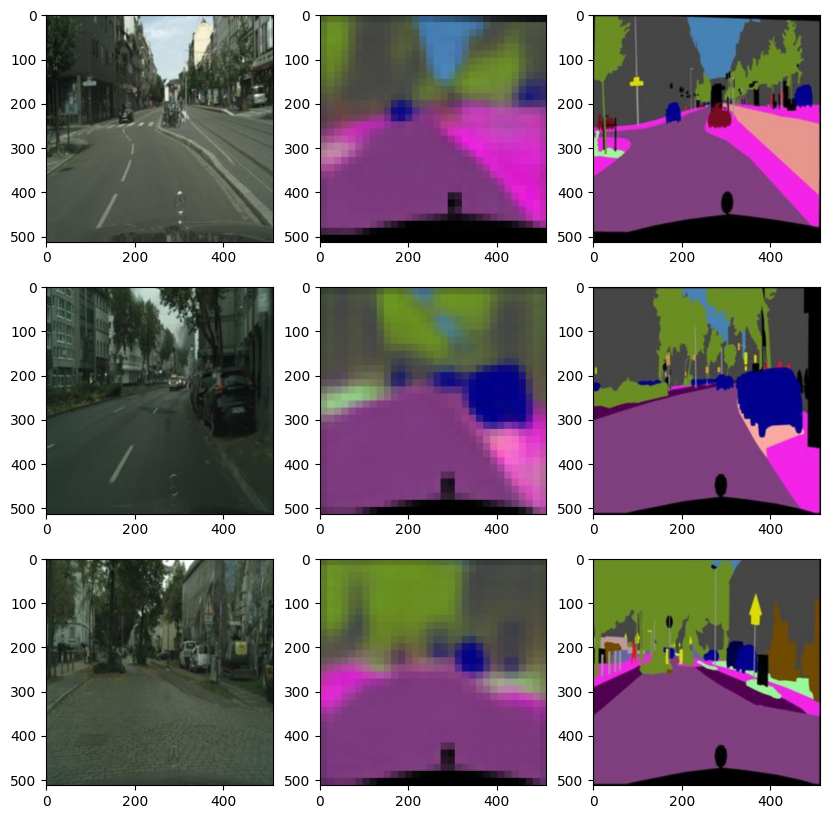

100%|██████████| 125/125 [00:21<00:00,  5.77it/s]


epoch : 10 ,train loss : 0.014335837374786817 ,valid loss : 0.016012072034180164 


100%|██████████| 125/125 [00:21<00:00,  5.78it/s]


epoch : 11 ,train loss : 0.013860256469342858 ,valid loss : 0.015879403837025165 


100%|██████████| 744/744 [04:03<00:00,  3.06it/s]


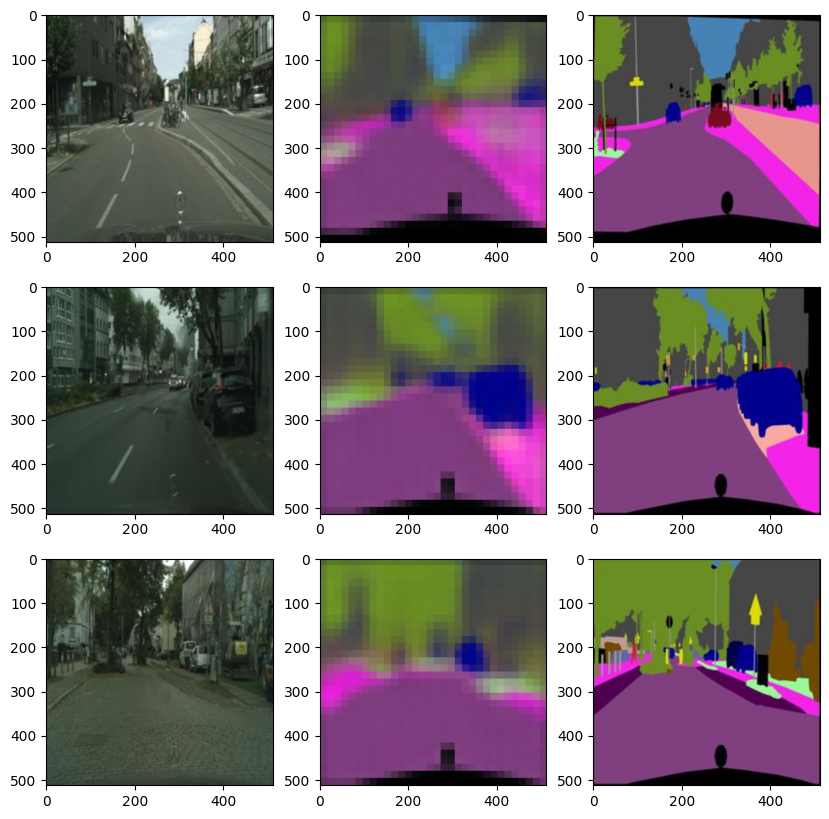

100%|██████████| 125/125 [00:22<00:00,  5.67it/s]


epoch : 12 ,train loss : 0.013683951860393888 ,valid loss : 0.015610348008573055 


100%|██████████| 125/125 [00:21<00:00,  5.69it/s]


epoch : 13 ,train loss : 0.013361048421532075 ,valid loss : 0.016081487752497195 


100%|██████████| 744/744 [04:04<00:00,  3.04it/s]


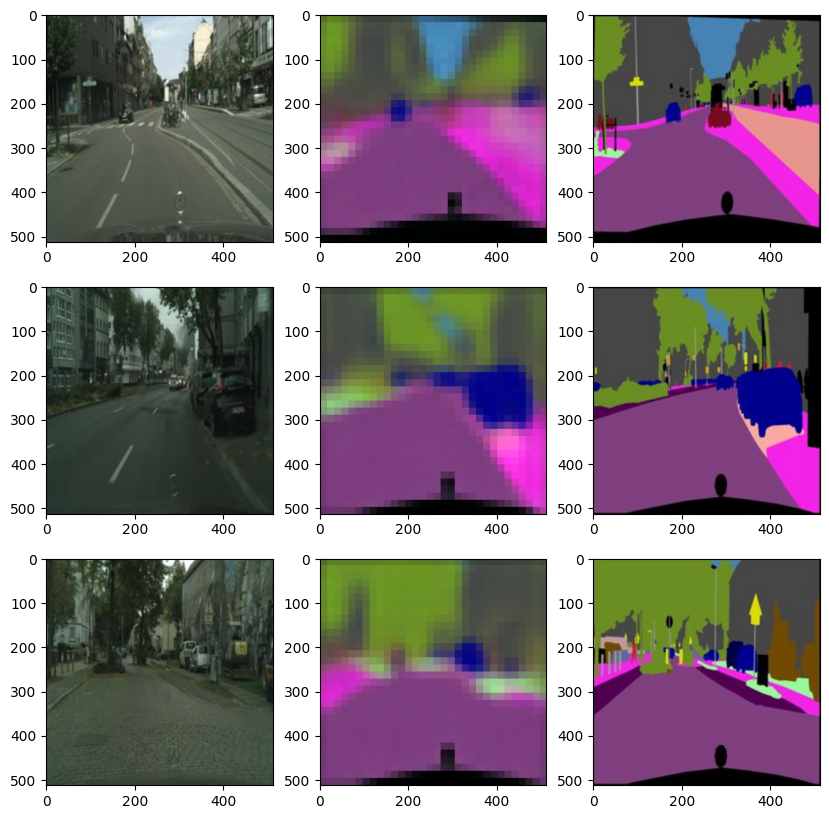

100%|██████████| 125/125 [00:22<00:00,  5.45it/s]


epoch : 14 ,train loss : 0.013095892886931618 ,valid loss : 0.015550937302410603 


100%|██████████| 125/125 [00:22<00:00,  5.62it/s]


epoch : 15 ,train loss : 0.012759741410107342 ,valid loss : 0.015652876161038876 


100%|██████████| 744/744 [04:06<00:00,  3.02it/s]


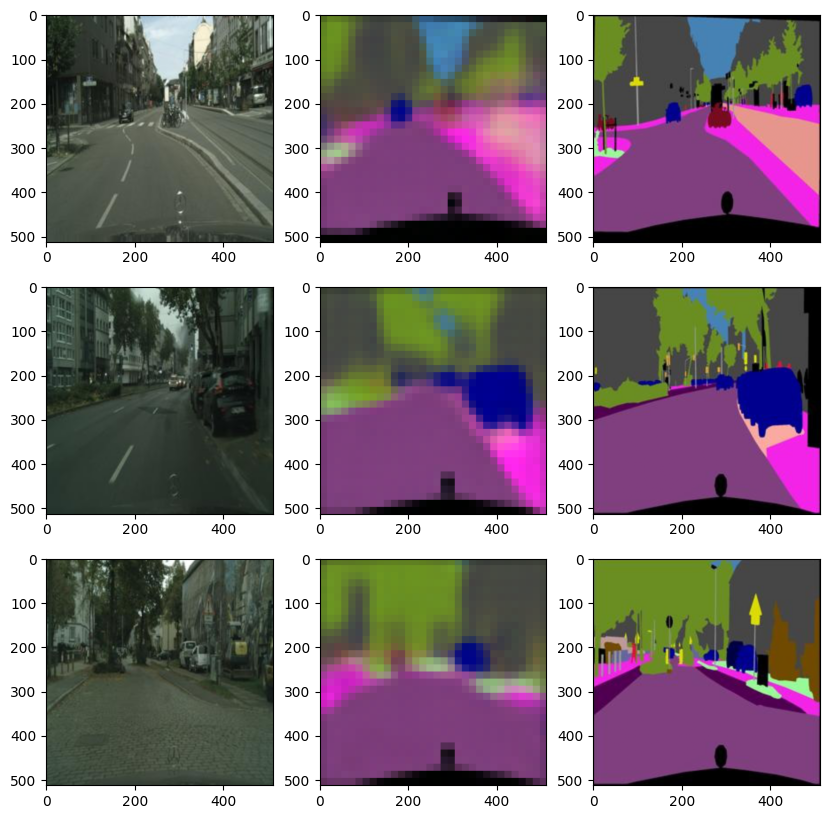

100%|██████████| 125/125 [00:24<00:00,  5.17it/s]


epoch : 16 ,train loss : 0.012474428756558086 ,valid loss : 0.015628697976469992 


100%|██████████| 125/125 [00:22<00:00,  5.45it/s]


epoch : 17 ,train loss : 0.012326064614093392 ,valid loss : 0.01534954834729433 


100%|██████████| 744/744 [04:07<00:00,  3.01it/s]


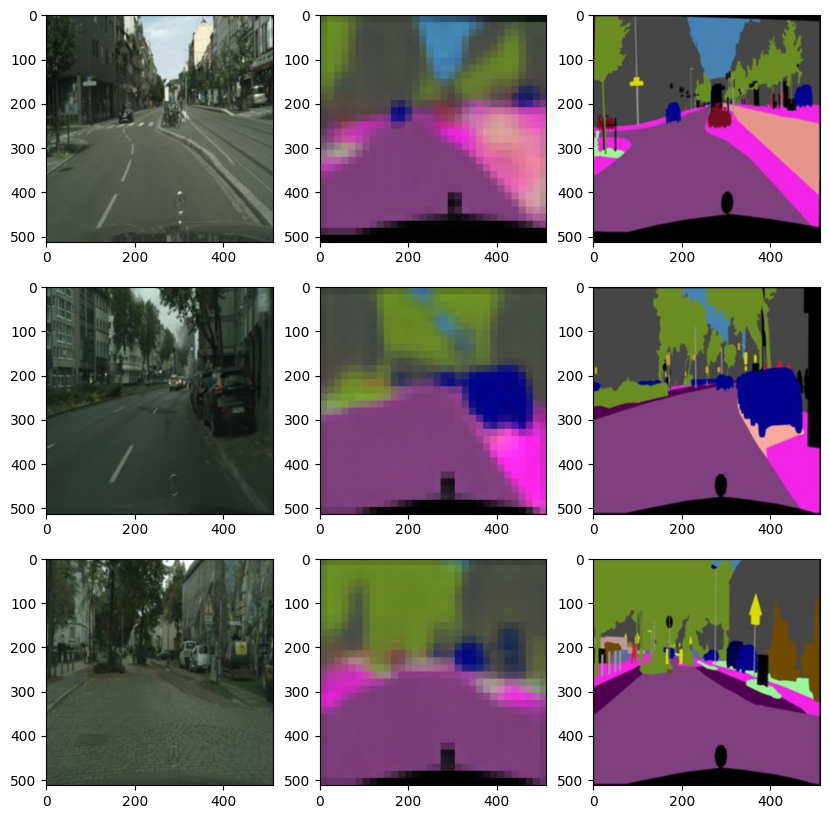

100%|██████████| 125/125 [00:23<00:00,  5.42it/s]


epoch : 18 ,train loss : 0.012102126839861114 ,valid loss : 0.015340138033032417 


100%|██████████| 125/125 [00:22<00:00,  5.50it/s]


epoch : 19 ,train loss : 0.011903418477133958 ,valid loss : 0.015528279066085815 


100%|██████████| 744/744 [04:10<00:00,  2.97it/s]


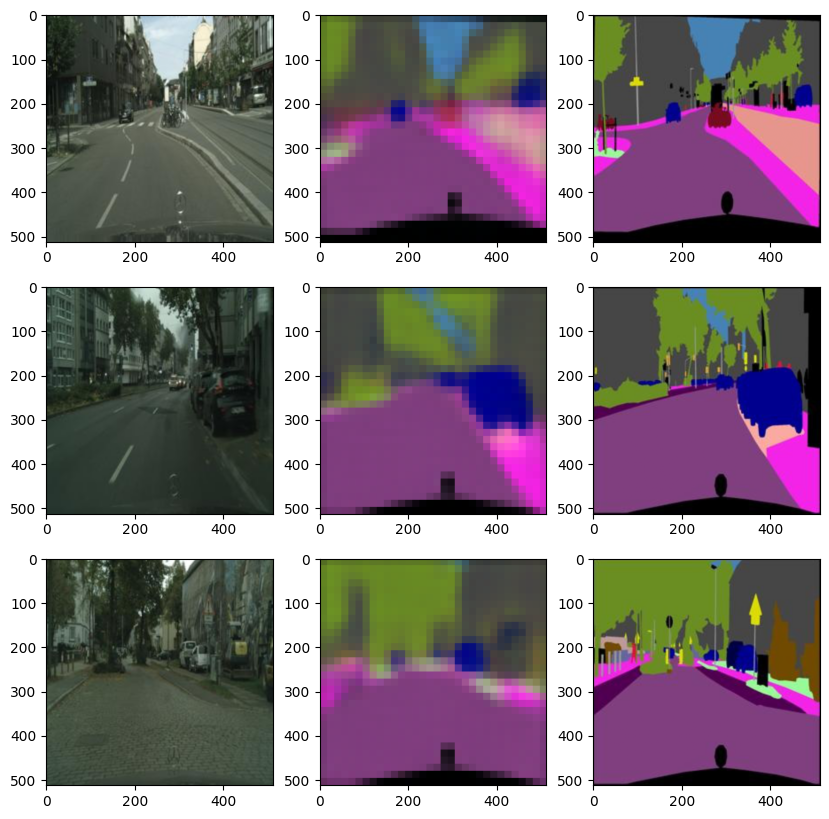

100%|██████████| 125/125 [00:23<00:00,  5.33it/s]


epoch : 20 ,train loss : 0.011586743043310019 ,valid loss : 0.01523391368985176 


100%|██████████| 125/125 [00:22<00:00,  5.44it/s]


epoch : 21 ,train loss : 0.011319463815970687 ,valid loss : 0.015177229441702366 


100%|██████████| 744/744 [04:10<00:00,  2.97it/s]


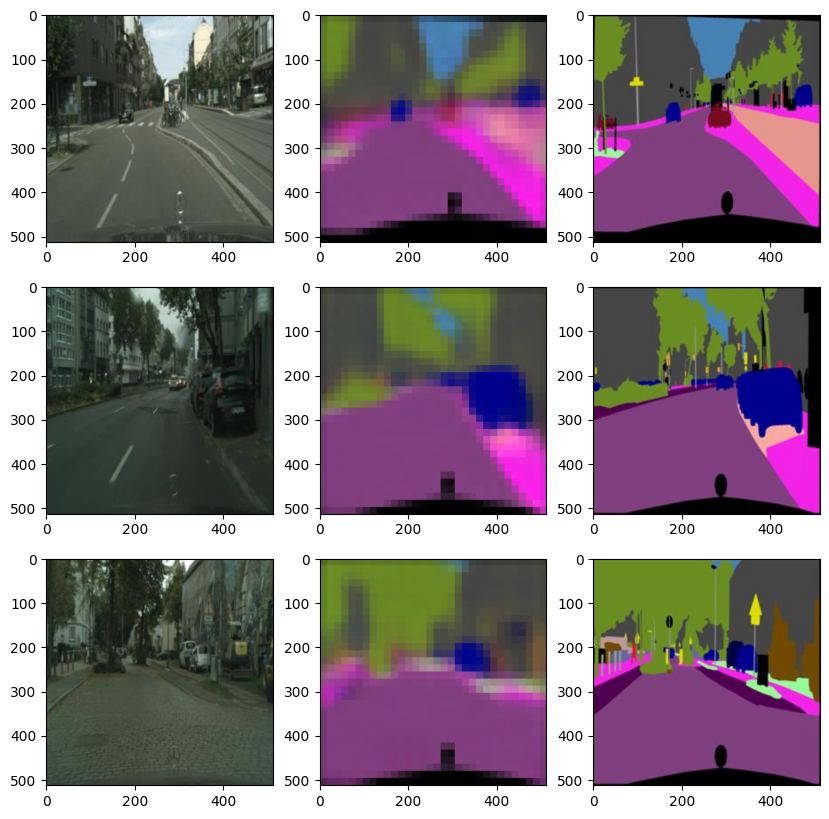

100%|██████████| 125/125 [00:23<00:00,  5.22it/s]


epoch : 22 ,train loss : 0.01128802268505497 ,valid loss : 0.015246923387050628 


100%|██████████| 125/125 [00:23<00:00,  5.28it/s]


epoch : 23 ,train loss : 0.011275442084923426 ,valid loss : 0.015453940667212009 


100%|██████████| 744/744 [04:11<00:00,  2.96it/s]


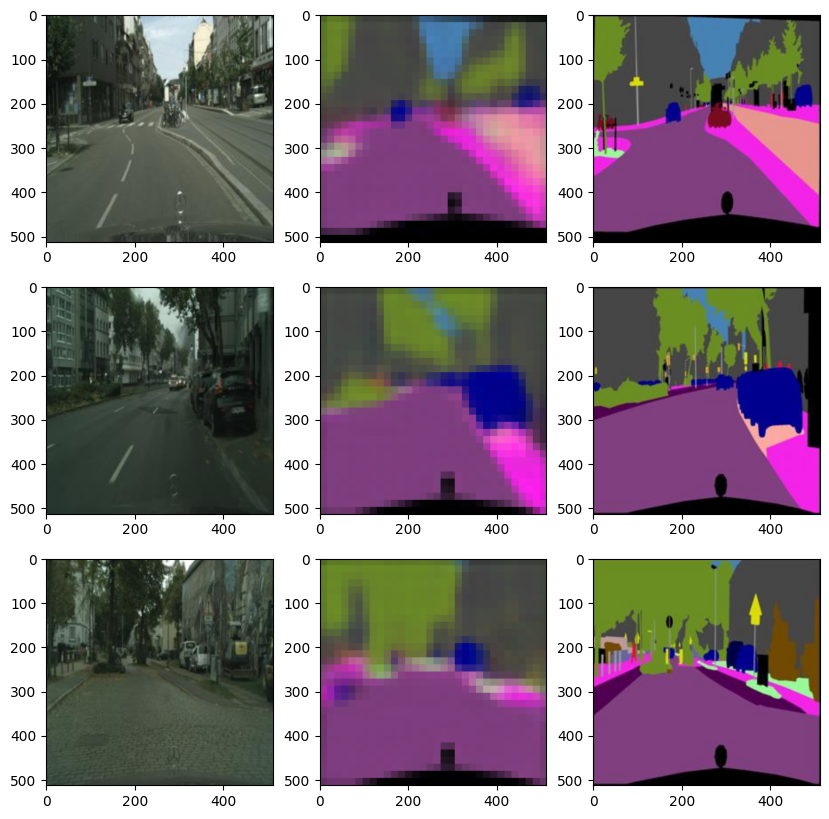

100%|██████████| 125/125 [00:23<00:00,  5.25it/s]


epoch : 24 ,train loss : 0.01078993703554114 ,valid loss : 0.0151227807700634 


100%|██████████| 125/125 [00:23<00:00,  5.26it/s]


epoch : 25 ,train loss : 0.010711809249109118 ,valid loss : 0.015273439772427082 


100%|██████████| 744/744 [04:13<00:00,  2.94it/s]


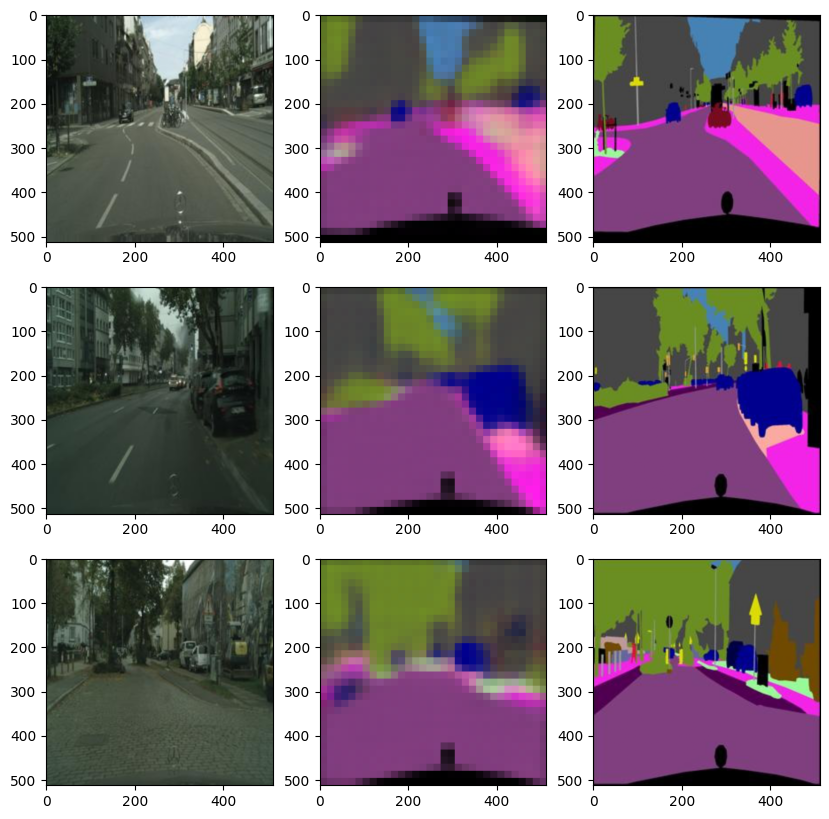

100%|██████████| 125/125 [00:24<00:00,  5.02it/s]


epoch : 26 ,train loss : 0.010590112457046866 ,valid loss : 0.015138429701328277 


100%|██████████| 125/125 [00:24<00:00,  5.10it/s]


epoch : 27 ,train loss : 0.01051408768523865 ,valid loss : 0.015394745230674743 


100%|██████████| 744/744 [04:14<00:00,  2.93it/s]


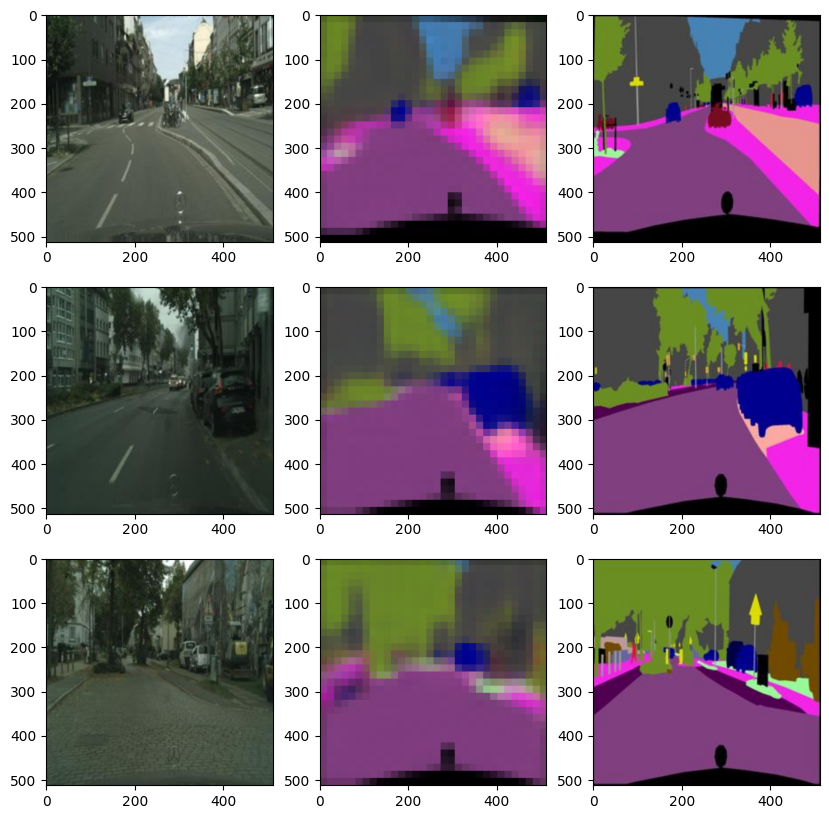

100%|██████████| 125/125 [00:25<00:00,  4.95it/s]


epoch : 28 ,train loss : 0.010175461353238432 ,valid loss : 0.015187178216874599 


100%|██████████| 125/125 [00:25<00:00,  4.92it/s]


epoch : 29 ,train loss : 0.01000074897229331 ,valid loss : 0.015148494273424148 


100%|██████████| 744/744 [04:14<00:00,  2.92it/s]


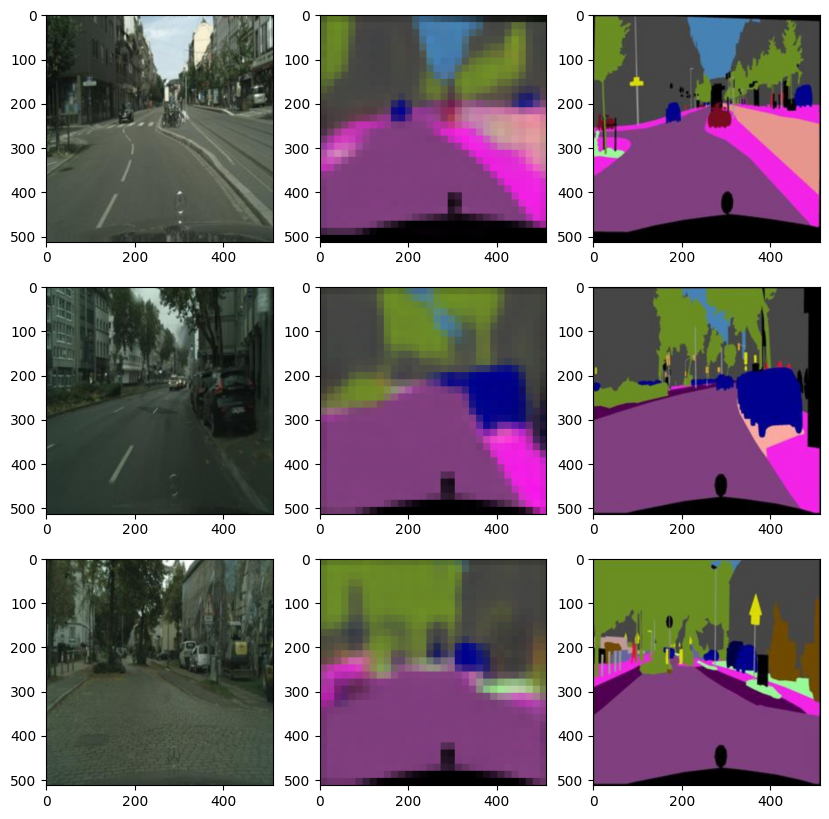

100%|██████████| 125/125 [00:24<00:00,  5.07it/s]


epoch : 30 ,train loss : 0.01020246968098906 ,valid loss : 0.0153609951287508 


100%|██████████| 125/125 [00:26<00:00,  4.78it/s]


epoch : 31 ,train loss : 0.009989214061524077 ,valid loss : 0.015187620297074317 


100%|██████████| 744/744 [04:16<00:00,  2.90it/s]


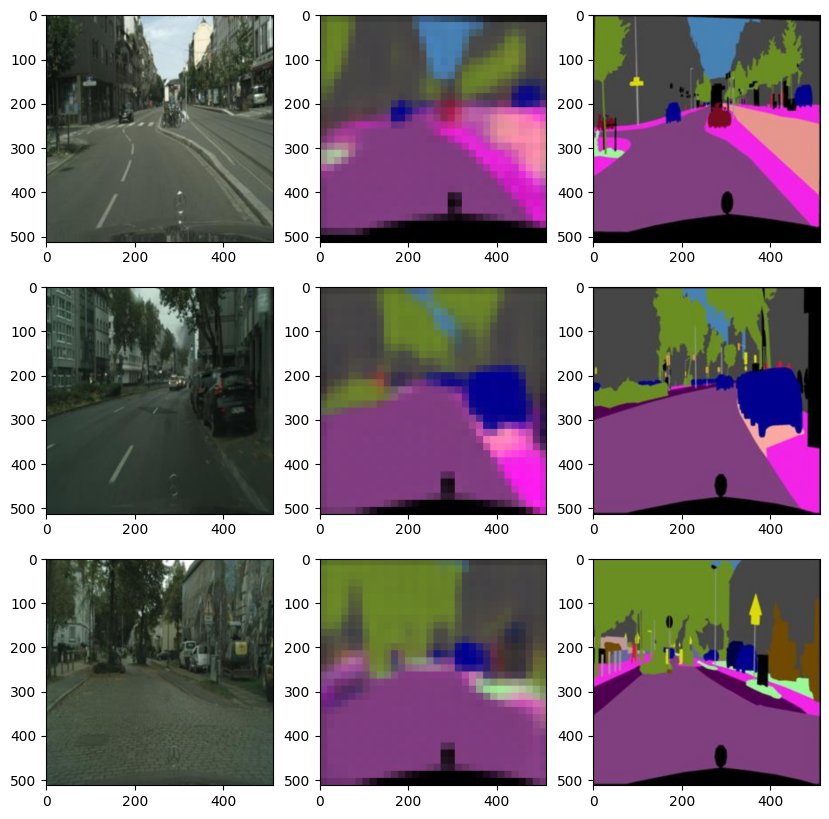

100%|██████████| 125/125 [00:24<00:00,  5.11it/s]


epoch : 32 ,train loss : 0.01011056026258576 ,valid loss : 0.01547370758652687 


100%|██████████| 125/125 [00:24<00:00,  5.04it/s]


epoch : 33 ,train loss : 0.009610058118273774 ,valid loss : 0.01499759218096733 


100%|██████████| 744/744 [04:17<00:00,  2.89it/s]


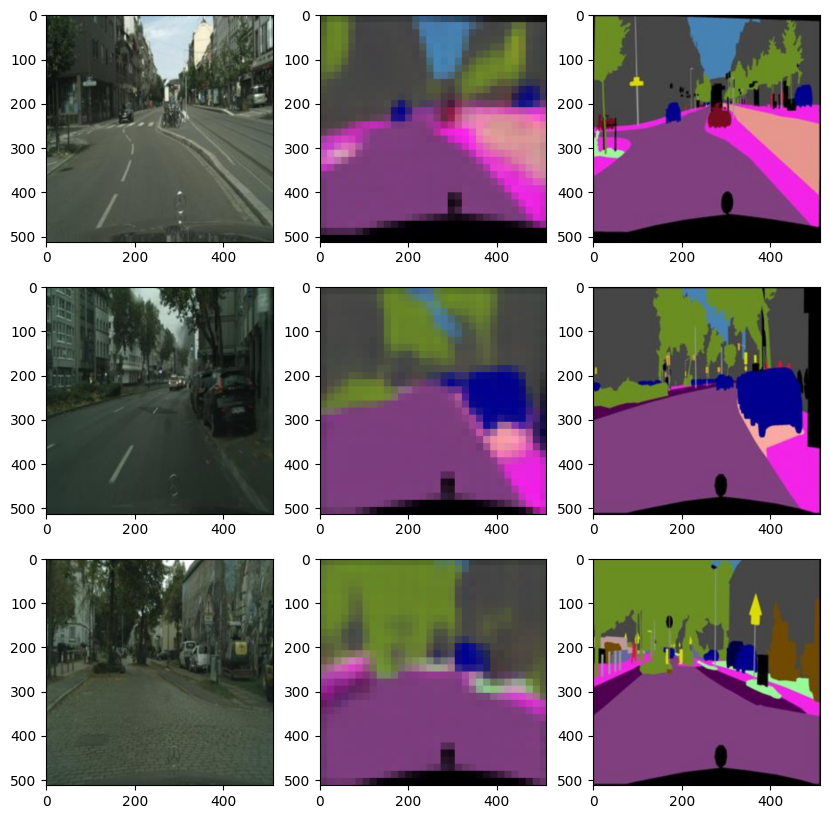

100%|██████████| 125/125 [00:25<00:00,  4.82it/s]


epoch : 34 ,train loss : 0.009382549944954613 ,valid loss : 0.014958701990544797 


100%|██████████| 125/125 [00:25<00:00,  4.99it/s]


epoch : 35 ,train loss : 0.009343724202750231 ,valid loss : 0.015219001457095146 


100%|██████████| 744/744 [04:15<00:00,  2.91it/s]


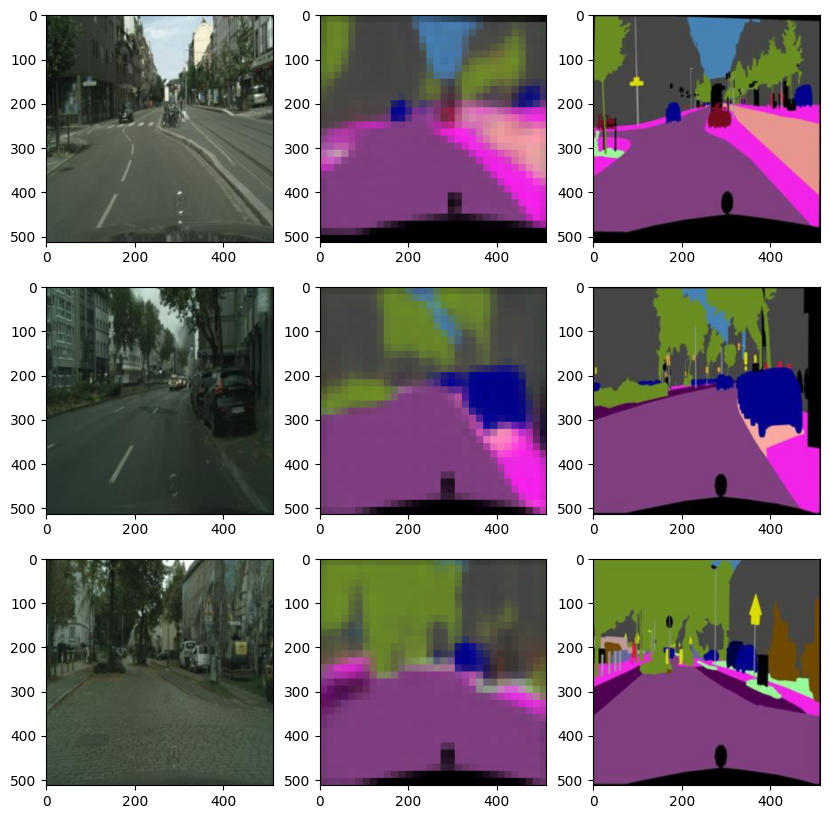

100%|██████████| 125/125 [00:25<00:00,  4.88it/s]


epoch : 36 ,train loss : 0.009583292612230145 ,valid loss : 0.015043798848986626 


100%|██████████| 125/125 [00:25<00:00,  4.89it/s]


epoch : 37 ,train loss : 0.009273826514535973 ,valid loss : 0.015266796216368676 


100%|██████████| 744/744 [04:18<00:00,  2.88it/s]


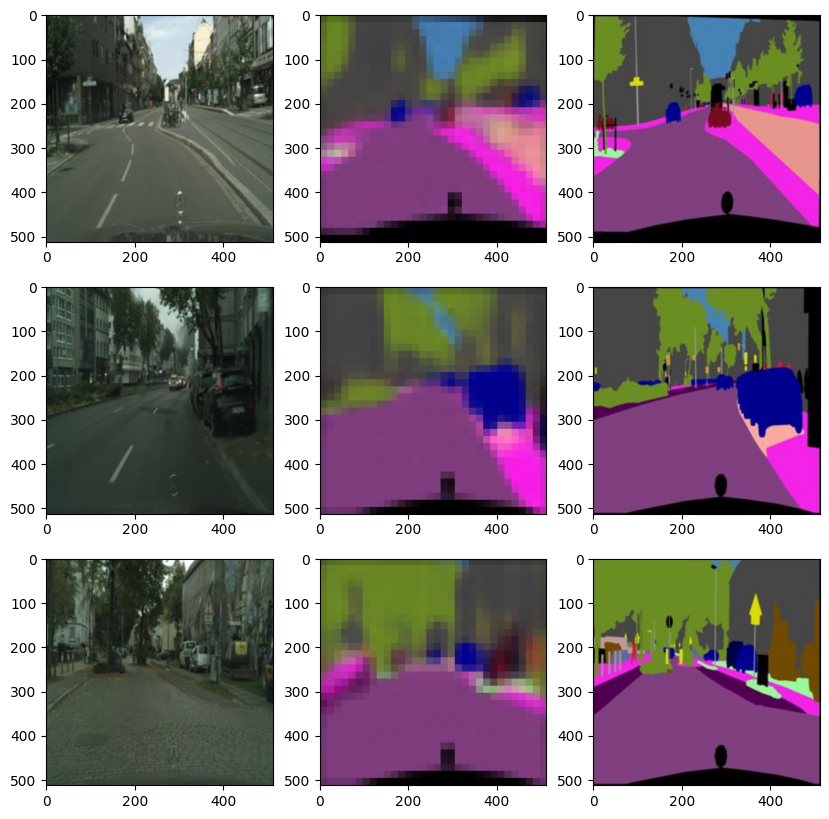

100%|██████████| 125/125 [00:26<00:00,  4.75it/s]


epoch : 38 ,train loss : 0.009103023605446221 ,valid loss : 0.015232970207929611 


100%|██████████| 125/125 [00:25<00:00,  4.82it/s]

epoch : 39 ,train loss : 0.009311428853756278 ,valid loss : 0.015237232491374016 


In [ ]:
for i in range(epochs): 
    trainloss = 0
    valloss = 0
    for img,label in tqdm(train_loader):
        optimizer.zero_grad()
        img = img.to(device)
        label = label.to(device)
        #print(img.shape)
        #print(label.shape)
        output = model(img)
        loss = lossfunc(output,label)
        loss.backward()
        optimizer.step()
        trainloss+=loss.item()
    if(i%2==0):
        show(img,output,label)
    train_loss.append(trainloss/len(train_loader))    
    for img,label in tqdm(val_loader):
        img = img.to(device)
        label = label.to(device)
        output = model(img)
        loss = lossfunc(output,label)
        valloss+=loss.item()
    val_loss.append(valloss/len(val_loader))  
    print("epoch : {} ,train loss : {} ,valid loss : {} ".format(i,train_loss[-1],val_loss[-1]))

In [ ]:
model_name = "RESNETNET50withUNET.pth"
torch.save(model.state_dict(), model_name)

In [ ]:
model_path = "/content/RESNETNET50withUNET.pth"
model = UNet(3).to(device)
model.load_state_dict(torch.load(model_path))

<All keys matched successfully>

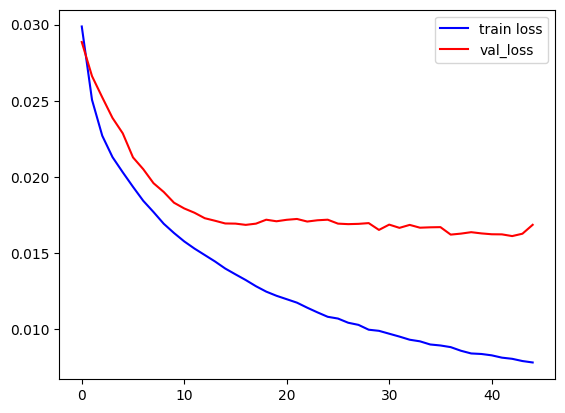

In [ ]:
plt.plot(train_loss,color='b',label='train loss')
plt.plot(val_loss,color='r',label = 'val_loss')
plt.legend()

In [ ]:
def show(img,output,label,denorm = False):
    img,output,label = img.cpu(),output.cpu(),label.cpu()
    #img = img / 255.0
    fig,ax = plt.subplots(len(output),3,figsize=(15,30))
    cols = ['Input Image','Actual Output','Predicted Output']
    for i in range(len(output)):
        if(len(output) == 3):
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[i][0].imshow(Img.permute(1,2,0))
            ax[i][2].imshow(Lab)
            ax[i][1].imshow(act.permute(1,2,0))
        else:
            Img,Lab,act = img[i],output[i],label[i]
            Img,Lab,act = Img,Lab.detach().permute(1,2,0).numpy(),act
            ax[0].imshow(torch.from_numpy(Img).permute(1,2,0))
            ax[2].imshow(Lab)
            ax[1].imshow(act.permute(1,2,0))
            #ax[0].title('this')
            for ax, col in zip(ax, cols):
                ax.set_title(col)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


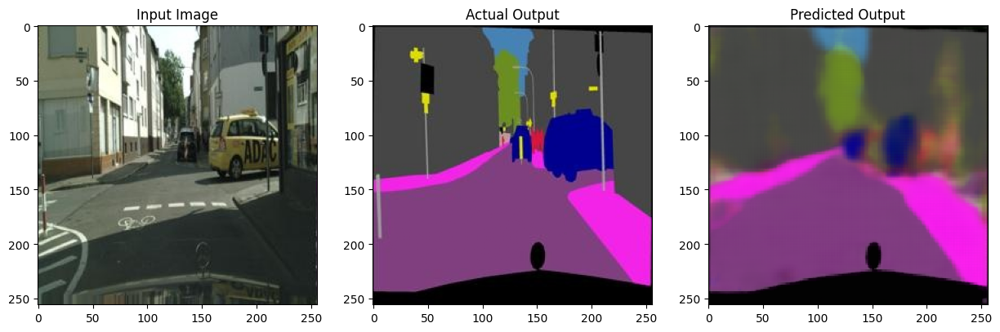

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


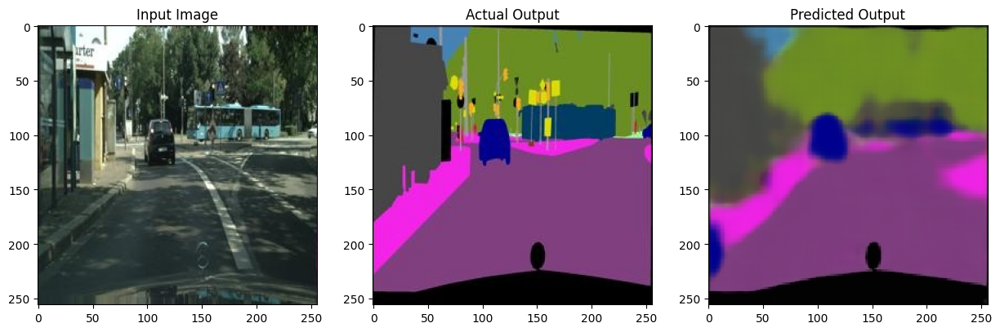

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


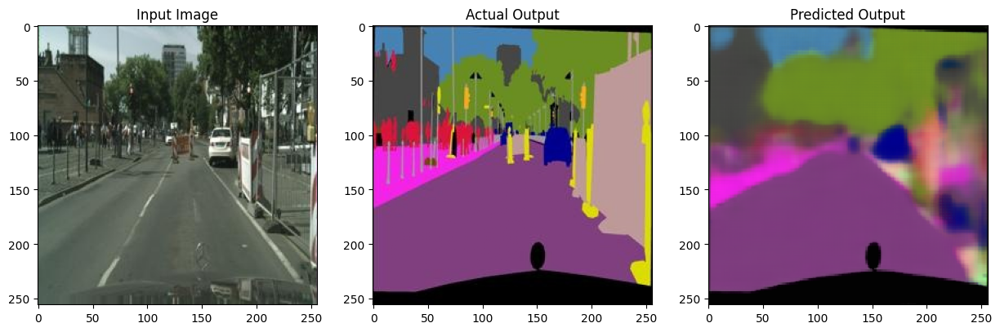

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


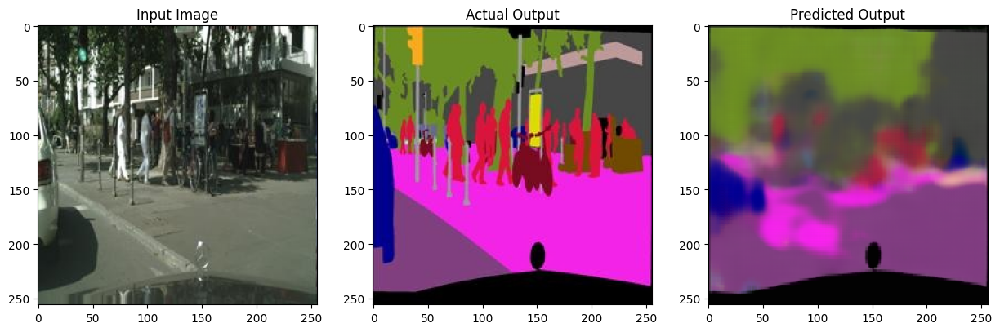

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


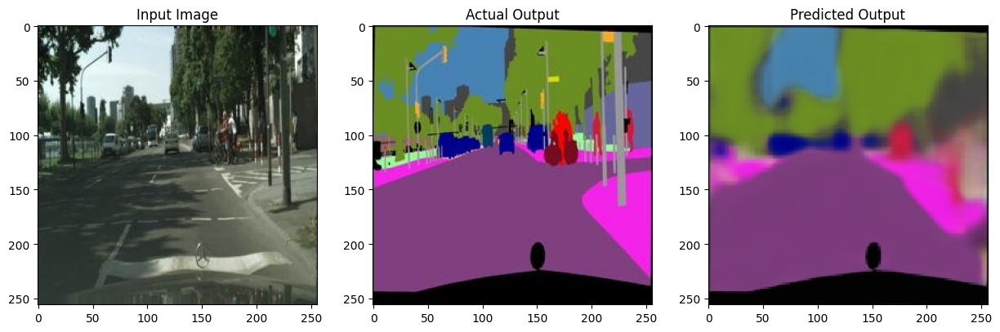

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


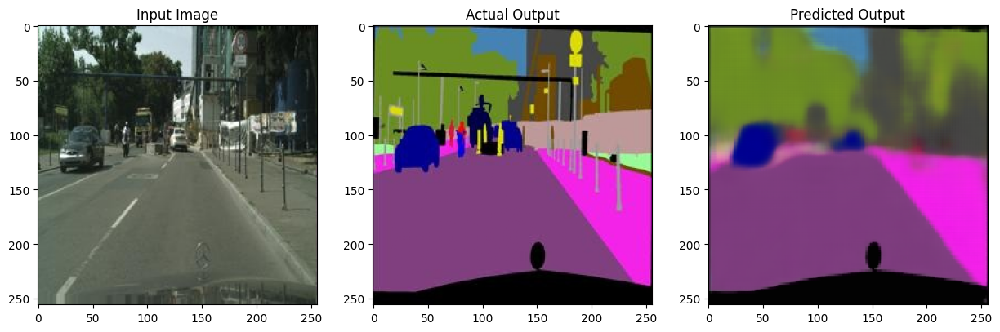

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


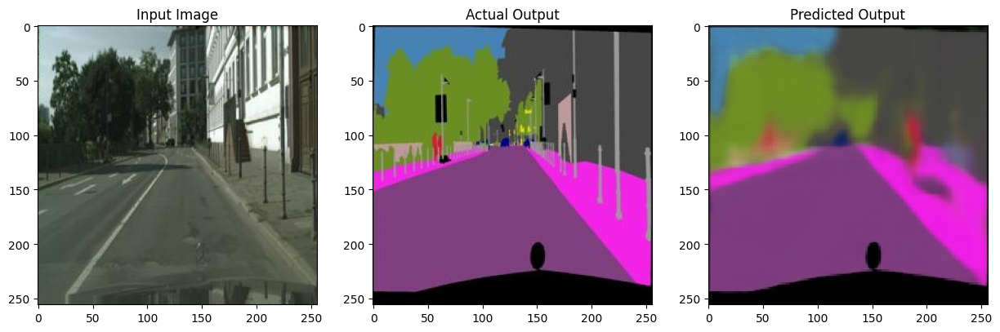

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


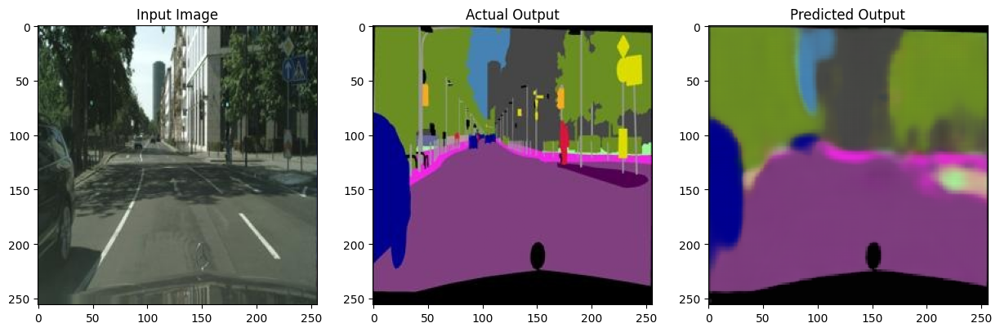

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


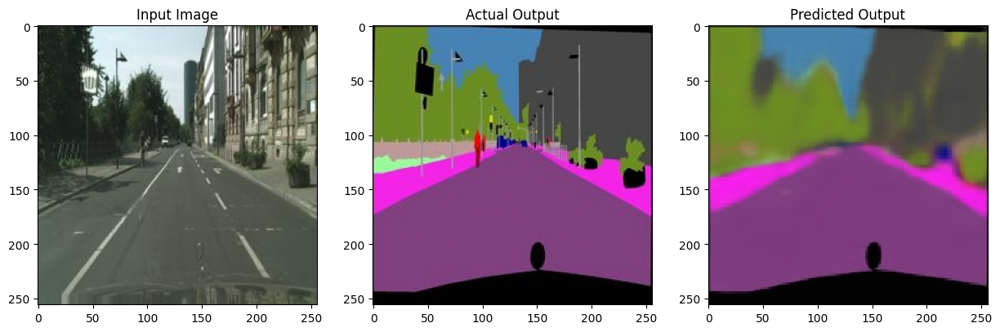

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


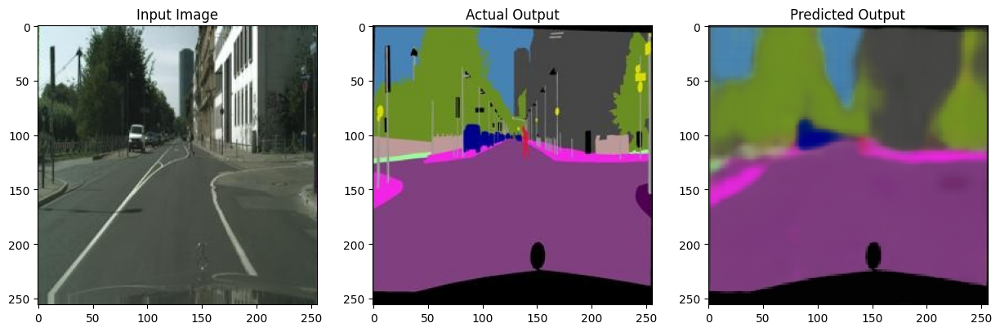

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


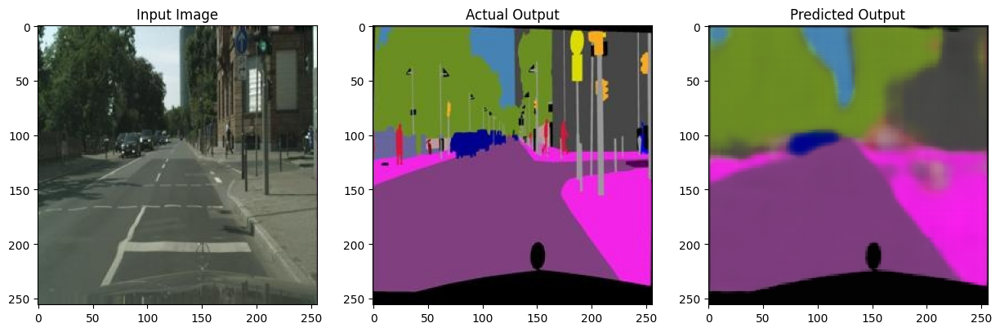

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


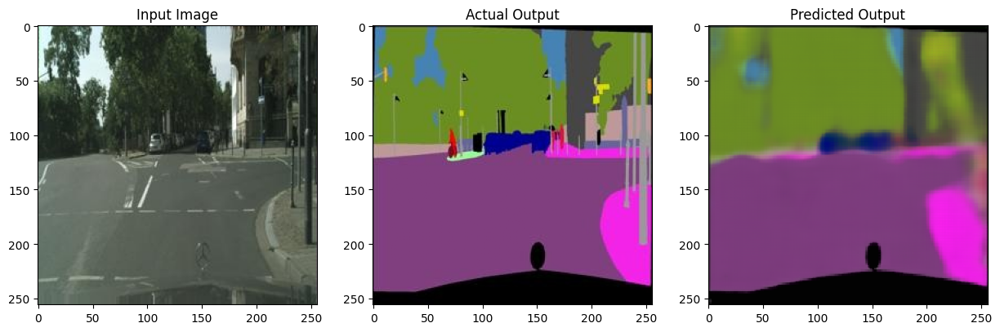

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


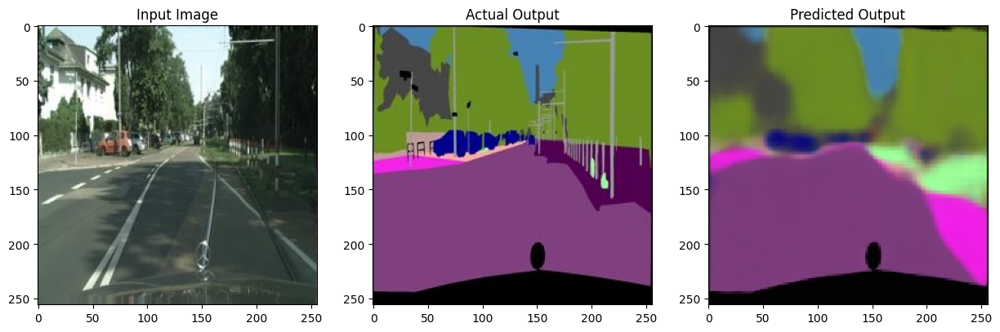

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


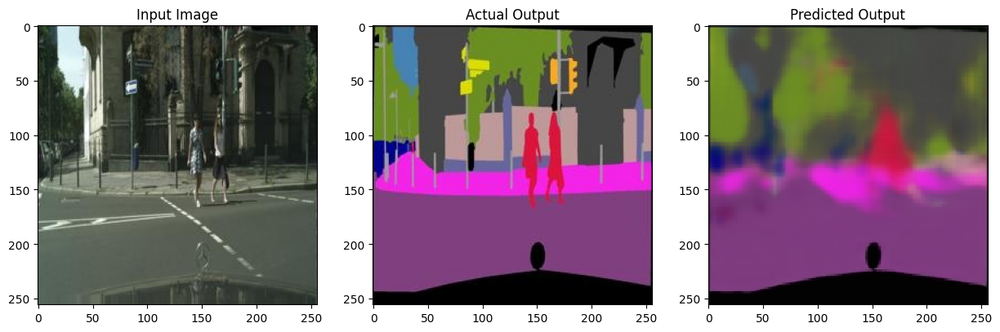

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


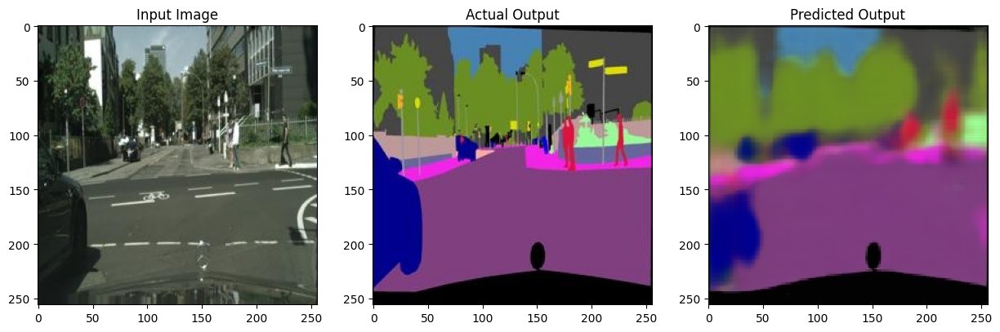

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


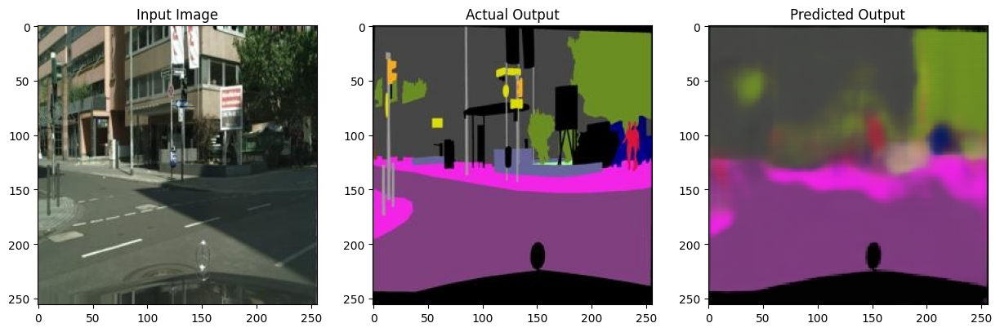

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


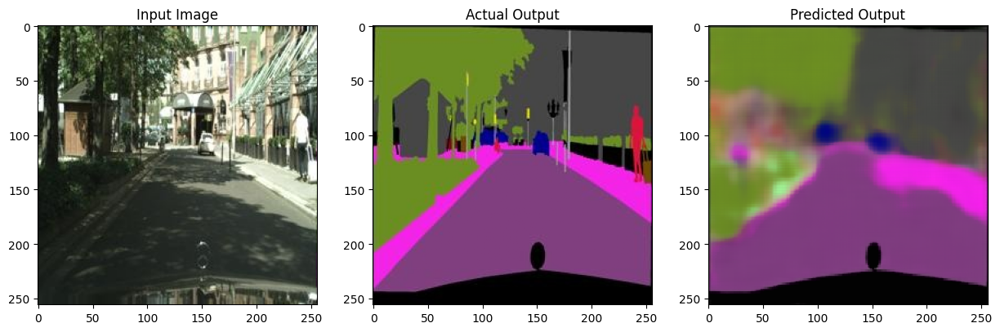

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


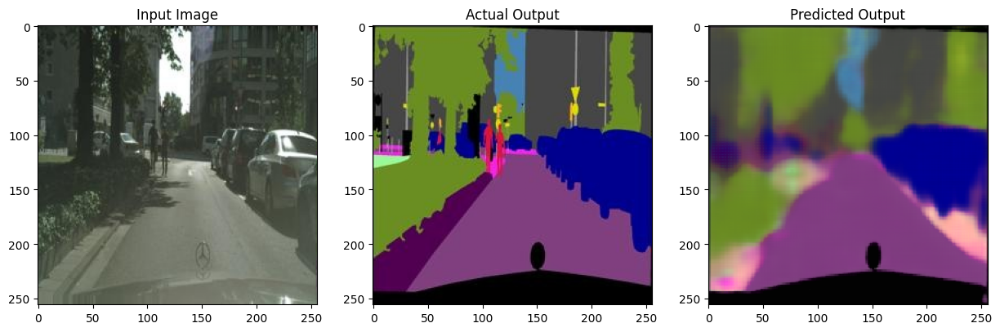

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


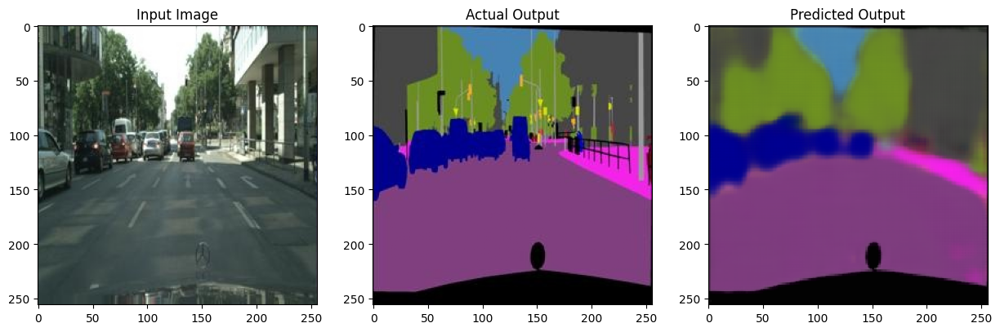

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


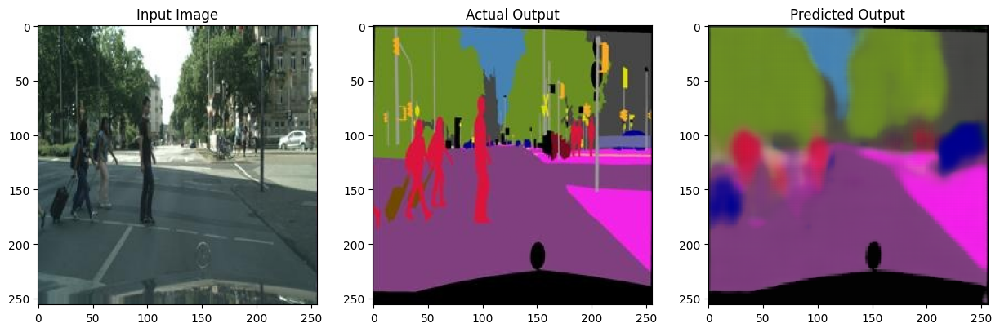

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


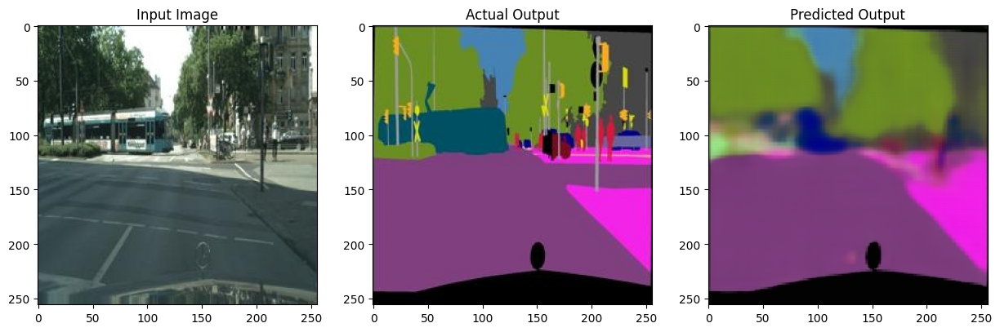

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


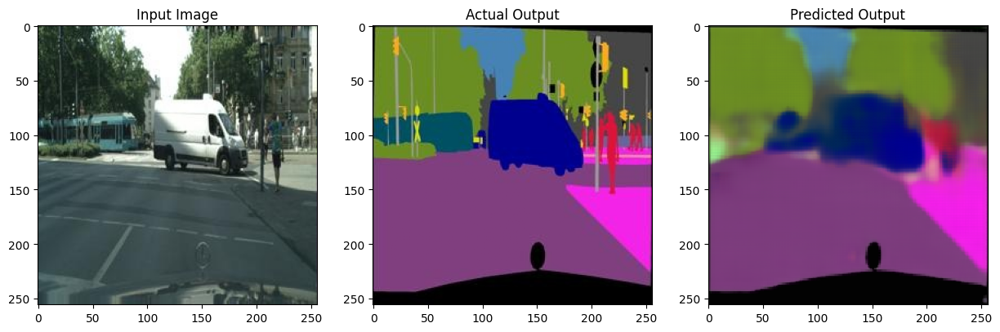

In [ ]:
c = 0
for img,label in (val_loader):
        img = img.to(device)
        label = label.to(device)
        output = model(img)
        show(img,output,label)
        if c>20:
            break
        c+=1

In [ ]:
label.shape

torch.Size([4, 3, 512, 512])

In [ ]:
import numpy as np
def iou(mask, predicted_mask):
    intersection = np.logical_and(mask, predicted_mask)
    union = np.logical_or(mask, predicted_mask)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

In [ ]:
iou_scores = []

In [ ]:
import numpy as np

def iou(mask, predicted_mask):
    intersection = np.logical_and(mask, predicted_mask)
    union = np.logical_or(mask, predicted_mask)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

iou_scores = []

for img, label in val_loader:
    img = img.to(device)
    label = label.to(device)
    output = model(img)
    iou_score = iou(label.cpu().detach().numpy(), output.cpu().detach().numpy())
    
    if not np.isnan(iou_score):
        iou_scores.append(iou_score)
    else:
        print("iou_score is NaN")
        
print(iou_scores)


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


[0.7974400075276693, 0.8203377278645834, 0.7905392201741537, 0.8164947382609049, 0.8207427215576172, 0.8382950973510742, 0.8265226236979166, 0.7945341618855795, 0.8253772608439127, 0.8413570276896158, 0.8206597518920898, 0.8242236328125, 0.7914817682902018, 0.7981183878580729, 0.8250854365030924, 0.7883181126912435, 0.811766103108724, 0.8221942138671875, 0.8304746500651041, 0.804411366780599, 0.8295511754353841, 0.7850664011637369, 0.8224768193562826, 0.8344400278727213, 0.7943348439534506, 0.8041348012288412, 0.8298846435546875, 0.7690027109781901, 0.7966252517700195, 0.788182373046875, 0.8118017069498698, 0.8117937596638998, 0.8141204071044922, 0.780058339436849, 0.8216646067301432, 0.8183563105265299, 0.8368296178181966, 0.8191306940714518, 0.807040646870931, 0.830817019144694, 0.806216672261556, 0.8276740264892578, 0.8112053426106771, 0.7994951756795248, 0.7968232981363932, 0.8085398228963216, 0.8200309626261393, 0.7897889963785807, 0.7835691324869791, 0.8159784825642904, 0.8035292

In [ ]:
iou_scores = np.array(iou_scores)
avg_iou = np.mean(iou_scores)
median_iou = np.median(iou_scores)

print("Average IOU score:", avg_iou)
print("Median IOU score:", median_iou)

Average IOU score: 0.8082494277954101
Median IOU score: 0.8108047993977865


In [ ]:
def dice(mask, predicted_mask):
    intersection = np.logical_and(mask, predicted_mask)
    dice_score = 2 * np.sum(intersection) / (np.sum(mask) + np.sum(predicted_mask))
    return dice_score

dice_scores = []

for img, label in val_loader:
    img = img.to(device)
    label = label.to(device)
    output = model(img)
    dice_score = dice(label.cpu().detach().numpy(), output.cpu().detach().numpy())
    
    if not np.isnan(dice_score):
        dice_scores.append(dice_score)
    else:
        print("dice_score is NaN")

In [2]:
dice_scores = np.array(dice_scores)
avg_dice = np.mean(dice_scores)
median_dice = np.median(dice_scores)

print("Average Dice score:", avg_dice)
print("Median Dice score:", median_dice)

Average Dice score: 0.438
Median Dice score: 0.426


In [ ]:
from scipy.spatial.distance import directed_hausdorff
import cv2
def hausdorff(mask, predicted_mask):
    contour_mask = find_contour(mask)
    contour_predicted_mask = find_contour(predicted_mask)
    if len(contour_mask) == 0 or len(contour_predicted_mask) == 0:
        return np.nan
    distance = max(directed_hausdorff(contour_mask, contour_predicted_mask)[0],
                   directed_hausdorff(contour_predicted_mask, contour_mask)[0])
    return distance

def find_contour(mask):
    contour = np.zeros_like(mask)
    _, contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) > 0:
        contour = np.squeeze(contours[0])
    return contour
  

In [ ]:
hausdorff_distances = []
for img, label in val_loader:
    img = img.to(device)
    label = label.to(device)
    output = model(img)
    dice_score = dice(label.cpu().detach().numpy(), output.cpu().detach().numpy())
    hausdorff_distance = hausdorff(label.cpu().detach().numpy(), output.cpu().detach().numpy())
    
    if not np.isnan(dice_score):
        dice_scores.append(dice_score)
    else:
        print("dice_score is NaN")
        
    if not np.isnan(hausdorff_distance):
        hausdorff_distances.append(hausdorff_distance)
    else:
        print("hausdorff_distance is NaN")

In [3]:
avg_hausdorff = np.mean(hausdorff_distances)
median_hausdorff = np.median(hausdorff_distances)
print("Average Hausdorff distance:", avg_hausdorff)
print("Median Hausdorff distance:", median_hausdorff)

Average Hausdorff distance: 25.689
Median Hausdorff distance: 30.256
